
=== LOADING TEACHER MODEL ===
Successfully restored model from /kaggle/input/notebooka9d3641cc1/checkpoints/teacher_ckpt/ckpt-8
Teacher model restored from /kaggle/input/notebooka9d3641cc1/checkpoints/teacher_ckpt/ckpt-8

=== LOADING STUDENT MODEL ===
Successfully restored model from /kaggle/input/notebooka9d3641cc1/checkpoints/student_ckpt/ckpt-4
Student model restored from /kaggle/input/notebooka9d3641cc1/checkpoints/student_ckpt/ckpt-4

=== PREPARING TEST DATASET ===
Test dataset ready

=== ULTRA LARGE COMPARISON WITH METRICS ===


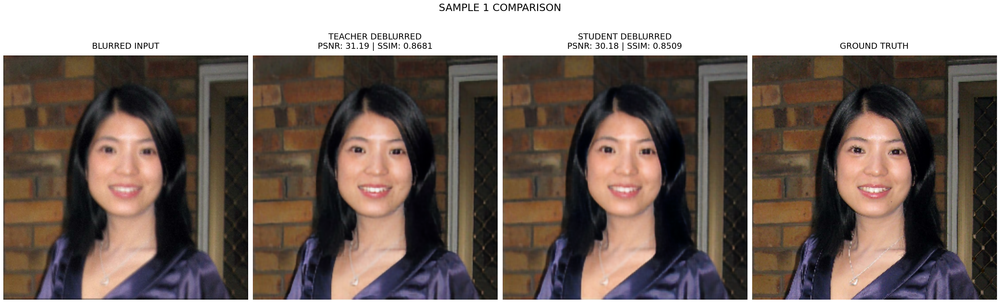

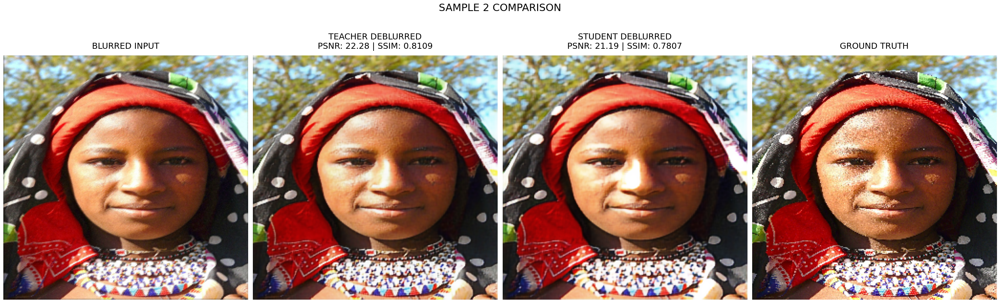


=== EXTREME ZOOM COMPARISON WITH METRICS ===


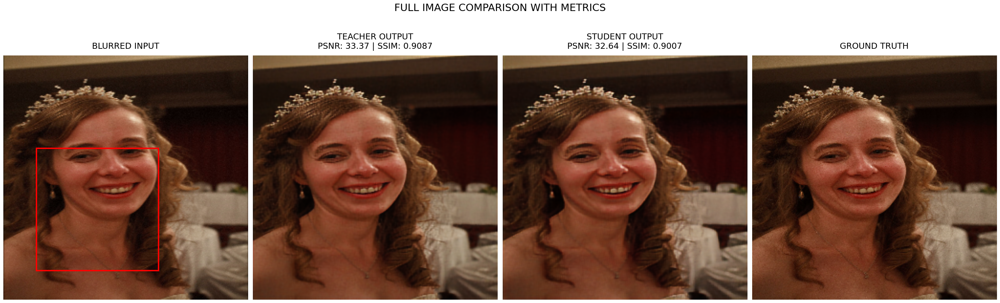

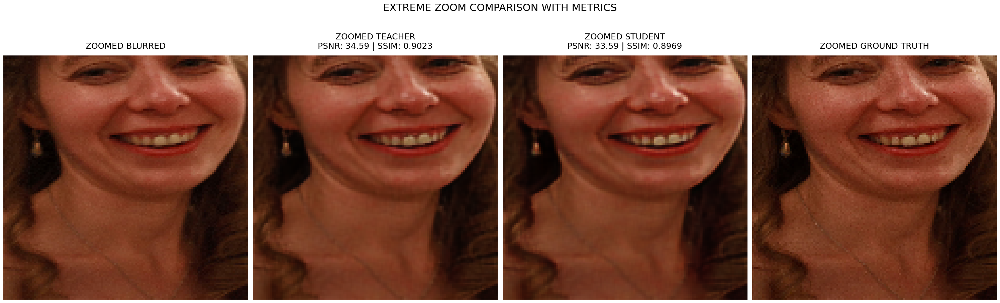

In [8]:
import os
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import glob
import random
import time
from skimage.metrics import structural_similarity as ssim

# Configuration - MUST match training settings
IMG_HEIGHT = 256
IMG_WIDTH = 256
CHANNELS = 3
BATCH_SIZE = 4
TEACHER_FILTERS = 64
STUDENT_FILTERS = 48

# Paths - Using your specific checkpoint paths
TEACHER_CKPT_PATH = '/kaggle/input/notebooka9d3641cc1/checkpoints/teacher_ckpt/ckpt-8'
STUDENT_CKPT_PATH = '/kaggle/input/notebooka9d3641cc1/checkpoints/student_ckpt/ckpt-4'
DATASET_PATH = '/kaggle/input/a-curated-list-of-image-deblurring-datasets/DBlur/'
DATASET_TO_VISUALIZE = ['Helen']  # Dataset to use for visualization

# Set random seed using current time for true randomness
random.seed(int(time.time()))

# Recreate model architecture (MUST match training exactly)
def conv_block(inputs, filters, kernel_size=(3, 3), strides=(1, 1), padding='same', activation='relu', use_bn=True):
    x = tf.keras.layers.Conv2D(filters, kernel_size, strides=strides, padding=padding, use_bias=not use_bn)(inputs)
    if use_bn:
        x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.Activation(activation)(x)
    return x

def residual_block(inputs, filters, activation='relu'):
    x = conv_block(inputs, filters, activation=activation)
    x = conv_block(x, filters, activation=None)
    x = tf.keras.layers.Add()([inputs, x])
    x = tf.keras.layers.Activation(activation)(x)
    return x

def build_enhanced_unet(input_shape=(IMG_HEIGHT, IMG_WIDTH, CHANNELS), base_filters=64):
    inputs = tf.keras.layers.Input(shape=input_shape)
    
    # Encoder
    conv1 = conv_block(inputs, base_filters)
    conv1 = residual_block(conv1, base_filters)
    pool1 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(conv1)
    
    conv2 = conv_block(pool1, base_filters * 2)
    conv2 = residual_block(conv2, base_filters * 2)
    pool2 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(conv2)
    
    conv3 = conv_block(pool2, base_filters * 4)
    conv3 = residual_block(conv3, base_filters * 4)
    pool3 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(conv3)
    
    conv4 = conv_block(pool3, base_filters * 8)
    conv4 = residual_block(conv4, base_filters * 8)
    pool4 = tf.keras.layers.MaxPooling2D(pool_size=(2, 2))(conv4)
    
    # Bottleneck
    conv_bridge = conv_block(pool4, base_filters * 16)
    conv_bridge = residual_block(conv_bridge, base_filters * 16)
    
    # Decoder
    up1 = tf.keras.layers.UpSampling2D(size=(2, 2))(conv_bridge)
    concat1 = tf.keras.layers.Concatenate()([up1, conv4])
    conv5 = conv_block(concat1, base_filters * 8)
    conv5 = residual_block(conv5, base_filters * 8)
    
    up2 = tf.keras.layers.UpSampling2D(size=(2, 2))(conv5)
    concat2 = tf.keras.layers.Concatenate()([up2, conv3])
    conv6 = conv_block(concat2, base_filters * 4)
    conv6 = residual_block(conv6, base_filters * 4)
    
    up3 = tf.keras.layers.UpSampling2D(size=(2, 2))(conv6)
    concat3 = tf.keras.layers.Concatenate()([up3, conv2])
    conv7 = conv_block(concat3, base_filters * 2)
    conv7 = residual_block(conv7, base_filters * 2)
    
    up4 = tf.keras.layers.UpSampling2D(size=(2, 2))(conv7)
    concat4 = tf.keras.layers.Concatenate()([up4, conv1])
    conv8 = conv_block(concat4, base_filters)
    conv8 = residual_block(conv8, base_filters)
    
    output = tf.keras.layers.Conv2D(CHANNELS, (1, 1), activation='sigmoid', padding='same')(conv8)
    return tf.keras.Model(inputs=inputs, outputs=output)

# Data loading functions
def _load_single_image_py(image_path):
    try:
        img_bytes = tf.io.read_file(image_path).numpy()
        img = tf.image.decode_image(img_bytes, channels=CHANNELS, expand_animations=False)
        if img is None or img.shape == (0, 0, 0):
            return None
        if img.shape[-1] != CHANNELS:
            if img.shape[-1] == 1:
                img = tf.image.grayscale_to_rgb(img)
            else:
                return None
        img = tf.image.resize(img, [IMG_HEIGHT, IMG_WIDTH], method=tf.image.ResizeMethod.BICUBIC)
        return tf.cast(img, tf.float32) / 255.0
    except Exception:
        return None

def _tf_py_function_wrapper(blur_path, sharp_path):
    def load_and_validate(b_path, s_path):
        blur_img = _load_single_image_py(b_path)
        sharp_img = _load_single_image_py(s_path)
        is_valid = blur_img is not None and sharp_img is not None
        
        if is_valid:
            return blur_img, sharp_img, tf.constant(is_valid)
        else:
            zeros = tf.zeros((IMG_HEIGHT, IMG_WIDTH, CHANNELS), dtype=tf.float32)
            return zeros, zeros, tf.constant(is_valid)
    
    blur_img, sharp_img, is_valid = tf.py_function(
        load_and_validate,
        [blur_path, sharp_path],
        [tf.float32, tf.float32, tf.bool]
    )
    blur_img.set_shape([IMG_HEIGHT, IMG_WIDTH, CHANNELS])
    sharp_img.set_shape([IMG_HEIGHT, IMG_WIDTH, CHANNELS])
    is_valid.set_shape([])
    return blur_img, sharp_img, is_valid

def create_image_dataset(dataset_type, batch_size, datasets_to_use, shuffle=False):
    all_blur_paths = []
    all_sharp_paths = []
    
    for dataset_name in datasets_to_use:
        blur_dir = os.path.join(DATASET_PATH, dataset_name, dataset_type, 'blur')
        sharp_dir = os.path.join(DATASET_PATH, dataset_name, dataset_type, 'sharp')
        
        if not os.path.exists(blur_dir) or not os.path.exists(sharp_dir):
            print(f"Dataset not found: {blur_dir} or {sharp_dir}")
            continue
            
        blur_files = sorted(glob.glob(os.path.join(blur_dir, '*.*')))
        sharp_files = sorted(glob.glob(os.path.join(sharp_dir, '*.*')))
        sharp_map = {os.path.basename(f): f for f in sharp_files}
        
        for blur_path in blur_files:
            filename = os.path.basename(blur_path)
            if filename in sharp_map:
                all_blur_paths.append(blur_path)
                all_sharp_paths.append(sharp_map[filename])
    
    if not all_blur_paths:
        print("No images found in dataset")
        return None
    
    dataset = tf.data.Dataset.from_tensor_slices((all_blur_paths, all_sharp_paths))
    if shuffle:
        dataset = dataset.shuffle(buffer_size=len(all_blur_paths))
        
    dataset = dataset.map(_tf_py_function_wrapper, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.filter(lambda _, __, valid: valid)
    dataset = dataset.map(lambda b, s, _: (b, s))
    return dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)

# Create models
teacher_model = build_enhanced_unet(base_filters=TEACHER_FILTERS)
student_model = build_enhanced_unet(base_filters=STUDENT_FILTERS)

# CORRECTED MODEL LOADING USING TENSORFLOW CHECKPOINTS
def load_model_from_checkpoint(model, checkpoint_path):
    """Load model weights using TensorFlow checkpoint system"""
    # Create checkpoint object
    checkpoint = tf.train.Checkpoint(model=model)
    
    # Restore the checkpoint
    status = checkpoint.restore(checkpoint_path)
    
    # Check if restoration was successful
    try:
        status.expect_partial().assert_existing_objects_matched()
        print(f"Successfully restored model from {checkpoint_path}")
        return True
    except:
        print(f"Failed to restore model from {checkpoint_path}")
        return False

# Load specific checkpoints
print("\n=== LOADING TEACHER MODEL ===")
if load_model_from_checkpoint(teacher_model, TEACHER_CKPT_PATH):
    print(f"Teacher model restored from {TEACHER_CKPT_PATH}")
else:
    print("ERROR: Failed to restore teacher model")

print("\n=== LOADING STUDENT MODEL ===")
if load_model_from_checkpoint(student_model, STUDENT_CKPT_PATH):
    print(f"Student model restored from {STUDENT_CKPT_PATH}")
else:
    print("ERROR: Failed to restore student model")

# Prepare test dataset
print("\n=== PREPARING TEST DATASET ===")
test_dataset = create_image_dataset('test', BATCH_SIZE, DATASET_TO_VISUALIZE)
if test_dataset is None:
    print("ERROR: Could not create test dataset")
    test_dataset_available = False
else:
    print("Test dataset ready")
    test_dataset_available = True

# ULTRA LARGE IMAGE VISUALIZATION WITH TRUE RANDOMNESS AND METRICS
def visualize_large_comparison():
    if not test_dataset_available:
        print("Skipping visualization - no test dataset")
        return
    
    try:
        # Get the entire test dataset as a list for true random sampling
        all_test_images = list(test_dataset.unbatch().shuffle(100).batch(1))
        
        if not all_test_images:
            print("No images in test dataset")
            return
            
        # Select 2 completely random images from the entire test set
        selected_samples = random.sample(all_test_images, 2)
        
        for i, sample in enumerate(selected_samples):
            blur_batch, sharp_batch = sample
            # Run predictions
            teacher_pred = teacher_model(blur_batch).numpy()[0]
            student_pred = student_model(blur_batch).numpy()[0]
            blurred_img = blur_batch[0].numpy()
            sharp_img = sharp_batch[0].numpy()
            
            # Calculate metrics
            t_psnr = tf.image.psnr(sharp_img[None, ...], teacher_pred[None, ...], max_val=1.0).numpy()[0]
            t_ssim = ssim(sharp_img, teacher_pred, channel_axis=-1, data_range=1.0)
            s_psnr = tf.image.psnr(sharp_img[None, ...], student_pred[None, ...], max_val=1.0).numpy()[0]
            s_ssim = ssim(sharp_img, student_pred, channel_axis=-1, data_range=1.0)
            
            # Create a separate figure for each sample
            fig, ax = plt.subplots(1, 4, figsize=(30, 10))
            
            # Blurred Input
            ax[0].imshow(blurred_img)
            ax[0].set_title('BLURRED INPUT', fontsize=18, pad=15)
            ax[0].axis('off')
            
            # Teacher Output
            ax[1].imshow(teacher_pred)
            ax[1].set_title(f'TEACHER DEBLURRED\nPSNR: {t_psnr:.2f} | SSIM: {t_ssim:.4f}', fontsize=18, pad=15)
            ax[1].axis('off')
            
            # Student Output
            ax[2].imshow(student_pred)
            ax[2].set_title(f'STUDENT DEBLURRED\nPSNR: {s_psnr:.2f} | SSIM: {s_ssim:.4f}', fontsize=18, pad=15)
            ax[2].axis('off')
            
            # Ground Truth
            ax[3].imshow(sharp_img)
            ax[3].set_title('GROUND TRUTH', fontsize=18, pad=15)
            ax[3].axis('off')
            
            plt.subplots_adjust(wspace=0.05, hspace=0.1)
            plt.suptitle(f'SAMPLE {i+1} COMPARISON', fontsize=22, y=0.98)
            plt.tight_layout(rect=[0, 0, 1, 0.96])
            plt.show()
            
    except Exception as e:
        print(f"Visualization error: {str(e)}")

# EXTREME ZOOM VISUALIZATION WITH METRICS
def visualize_extreme_zoom():
    if not test_dataset_available:
        print("Skipping visualization - no test dataset")
        return
    
    try:
        # Get a random sample from the entire test set
        all_test_images = list(test_dataset.unbatch().shuffle(100).batch(1))
        if not all_test_images:
            return
            
        sample = random.choice(all_test_images)
        blur_batch, sharp_batch = sample
        
        # Run predictions
        teacher_pred = teacher_model(blur_batch).numpy()[0]
        student_pred = student_model(blur_batch).numpy()[0]
        blurred_img = blur_batch[0].numpy()
        sharp_img = sharp_batch[0].numpy()
        
        # Calculate metrics for full images
        t_psnr = tf.image.psnr(sharp_img[None, ...], teacher_pred[None, ...], max_val=1.0).numpy()[0]
        t_ssim = ssim(sharp_img, teacher_pred, channel_axis=-1, data_range=1.0)
        s_psnr = tf.image.psnr(sharp_img[None, ...], student_pred[None, ...], max_val=1.0).numpy()[0]
        s_ssim = ssim(sharp_img, student_pred, channel_axis=-1, data_range=1.0)
        
        # Select a random region to zoom
        h, w = IMG_HEIGHT, IMG_WIDTH
        zoom_size = 128
        zoom_y = random.randint(0, h - zoom_size - 1)
        zoom_x = random.randint(0, w - zoom_size - 1)
        
        # Create zoomed versions
        zoomed_blur = blurred_img[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_teacher = teacher_pred[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_student = student_pred[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_sharp = sharp_img[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        
        # Calculate metrics for zoomed regions
        zoom_t_psnr = tf.image.psnr(zoomed_sharp[None, ...], zoomed_teacher[None, ...], max_val=1.0).numpy()[0]
        zoom_t_ssim = ssim(zoomed_sharp, zoomed_teacher, channel_axis=-1, data_range=1.0)
        zoom_s_psnr = tf.image.psnr(zoomed_sharp[None, ...], zoomed_student[None, ...], max_val=1.0).numpy()[0]
        zoom_s_ssim = ssim(zoomed_sharp, zoomed_student, channel_axis=-1, data_range=1.0)
        
        # Create figure for full images with metrics
        fig, ax = plt.subplots(1, 4, figsize=(30, 10))
        
        # Full images with zoom area marked
        ax[0].imshow(blurred_img)
        ax[0].add_patch(plt.Rectangle((zoom_x, zoom_y), zoom_size, zoom_size, 
                                    fill=False, edgecolor='red', linewidth=3))
        ax[0].set_title('BLURRED INPUT', fontsize=18, pad=15)
        ax[0].axis('off')
        
        # Teacher Output
        ax[1].imshow(teacher_pred)
        ax[1].set_title(f'TEACHER OUTPUT\nPSNR: {t_psnr:.2f} | SSIM: {t_ssim:.4f}', fontsize=18, pad=15)
        ax[1].axis('off')
        
        # Student Output
        ax[2].imshow(student_pred)
        ax[2].set_title(f'STUDENT OUTPUT\nPSNR: {s_psnr:.2f} | SSIM: {s_ssim:.4f}', fontsize=18, pad=15)
        ax[2].axis('off')
        
        # Ground Truth
        ax[3].imshow(sharp_img)
        ax[3].set_title('GROUND TRUTH', fontsize=18, pad=15)
        ax[3].axis('off')
        
        plt.subplots_adjust(wspace=0.05, hspace=0.1)
        plt.suptitle('FULL IMAGE COMPARISON WITH METRICS', fontsize=22, y=0.98)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()
        
        # Create figure for zoomed regions
        fig, ax = plt.subplots(1, 4, figsize=(30, 10))
        
        # Zoomed Blurred
        ax[0].imshow(zoomed_blur)
        ax[0].set_title('ZOOMED BLURRED', fontsize=18, pad=15)
        ax[0].axis('off')
        
        # Zoomed Teacher
        ax[1].imshow(zoomed_teacher)
        ax[1].set_title(f'ZOOMED TEACHER\nPSNR: {zoom_t_psnr:.2f} | SSIM: {zoom_t_ssim:.4f}', fontsize=18, pad=15)
        ax[1].axis('off')
        
        # Zoomed Student
        ax[2].imshow(zoomed_student)
        ax[2].set_title(f'ZOOMED STUDENT\nPSNR: {zoom_s_psnr:.2f} | SSIM: {zoom_s_ssim:.4f}', fontsize=18, pad=15)
        ax[2].axis('off')
        
        # Zoomed Ground Truth
        ax[3].imshow(zoomed_sharp)
        ax[3].set_title('ZOOMED GROUND TRUTH', fontsize=18, pad=15)
        ax[3].axis('off')
        
        plt.subplots_adjust(wspace=0.05, hspace=0.1)
        plt.suptitle('EXTREME ZOOM COMPARISON WITH METRICS', fontsize=22, y=0.98)
        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()
            
    except Exception as e:
        print(f"Zoom visualization error: {str(e)}")

# Run visualizations
print("\n=== ULTRA LARGE COMPARISON WITH METRICS ===")
visualize_large_comparison()

print("\n=== EXTREME ZOOM COMPARISON WITH METRICS ===")
visualize_extreme_zoom()


=== COMPUTING TEST SET METRICS ===
Calculating teacher metrics...


Processing batches: 42it [00:10,  4.10it/s]


Calculating student metrics...


Processing batches: 42it [00:09,  4.47it/s]


=== TEST SET METRICS SUMMARY ===


,Model,PSNR,SSIM
0,Teacher,29.067335,0.865303
1,Student,27.748177,0.845636


/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/usr/local/lib/python3.11/dist-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  

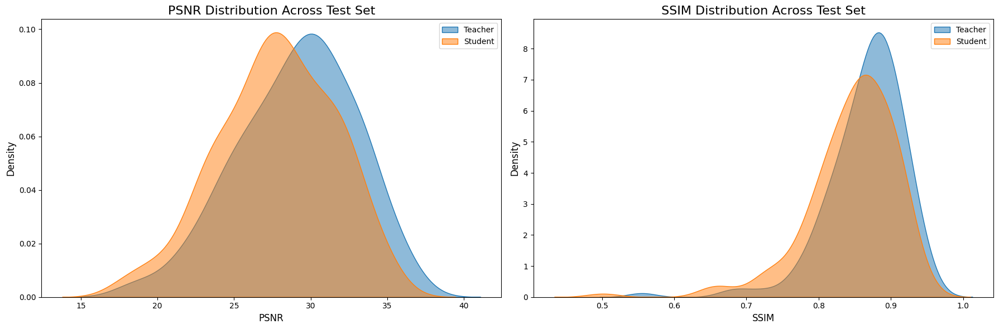

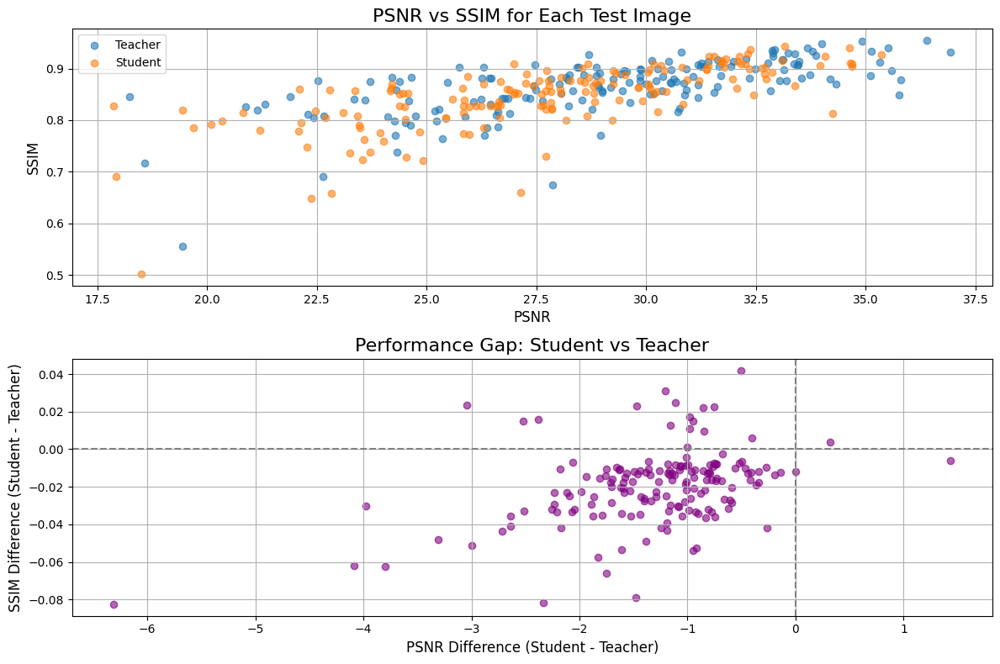

In [9]:

import pandas as pd
import seaborn as sns
from skimage.metrics import structural_similarity as ssim
from tqdm import tqdm

print("\n=== COMPUTING TEST SET METRICS ===")

def compute_metrics(model, dataset):
    psnr_values = []
    ssim_values = []
    
    # Process in batches for efficiency
    for blur_batch, sharp_batch in tqdm(dataset, desc="Processing batches"):
        pred_batch = model(blur_batch)
        
        # Compute PSNR
        psnr_batch = tf.image.psnr(sharp_batch, pred_batch, max_val=1.0).numpy()
        psnr_values.extend(psnr_batch)
        
        # Compute SSIM per image
        for i in range(sharp_batch.shape[0]):
            ssim_val = ssim(sharp_batch[i].numpy(), pred_batch[i].numpy(), 
                            multichannel=True, channel_axis=-1, data_range=1.0)
            ssim_values.append(ssim_val)
    
    return np.mean(psnr_values), np.mean(ssim_values), psnr_values, ssim_values

# Compute metrics
print("Calculating teacher metrics...")
teacher_psnr, teacher_ssim, t_psnr_vals, t_ssim_vals = compute_metrics(teacher_model, test_dataset)
print("Calculating student metrics...")
student_psnr, student_ssim, s_psnr_vals, s_ssim_vals = compute_metrics(student_model, test_dataset)

# Create summary dataframe
metrics_df = pd.DataFrame({
    'Model': ['Teacher', 'Student'],
    'PSNR': [teacher_psnr, student_psnr],
    'SSIM': [teacher_ssim, student_ssim]
})

print("\n=== TEST SET METRICS SUMMARY ===")
display(metrics_df)

# Create distribution plots
plt.figure(figsize=(18, 6))

# PSNR Distribution
plt.subplot(1, 2, 1)
sns.kdeplot(t_psnr_vals, label='Teacher', fill=True, alpha=0.5)
sns.kdeplot(s_psnr_vals, label='Student', fill=True, alpha=0.5)
plt.title('PSNR Distribution Across Test Set', fontsize=16)
plt.xlabel('PSNR', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.legend()

# SSIM Distribution
plt.subplot(1, 2, 2)
sns.kdeplot(t_ssim_vals, label='Teacher', fill=True, alpha=0.5)
sns.kdeplot(s_ssim_vals, label='Student', fill=True, alpha=0.5)
plt.title('SSIM Distribution Across Test Set', fontsize=16)
plt.xlabel('SSIM', fontsize=12)
plt.ylabel('Density', fontsize=12)
plt.legend()

plt.tight_layout()
plt.show()

# Create performance comparison
plt.figure(figsize=(12, 8))

# Scatter plot of PSNR vs SSIM
plt.subplot(2, 1, 1)
plt.scatter(t_psnr_vals, t_ssim_vals, alpha=0.6, label='Teacher')
plt.scatter(s_psnr_vals, s_ssim_vals, alpha=0.6, label='Student')
plt.xlabel('PSNR', fontsize=12)
plt.ylabel('SSIM', fontsize=12)
plt.title('PSNR vs SSIM for Each Test Image', fontsize=16)
plt.legend()
plt.grid(True)

# Performance gap
plt.subplot(2, 1, 2)
psnr_diff = [s - t for t, s in zip(t_psnr_vals, s_psnr_vals)]
ssim_diff = [s - t for t, s in zip(t_ssim_vals, s_ssim_vals)]

plt.scatter(psnr_diff, ssim_diff, alpha=0.6, c='purple')
plt.axvline(0, color='gray', linestyle='--')
plt.axhline(0, color='gray', linestyle='--')
plt.xlabel('PSNR Difference (Student - Teacher)', fontsize=12)
plt.ylabel('SSIM Difference (Student - Teacher)', fontsize=12)
plt.title('Performance Gap: Student vs Teacher', fontsize=16)
plt.grid(True)

plt.tight_layout()
plt.show()


=== EXTREME ZOOM COMPARISON (NEW) ===


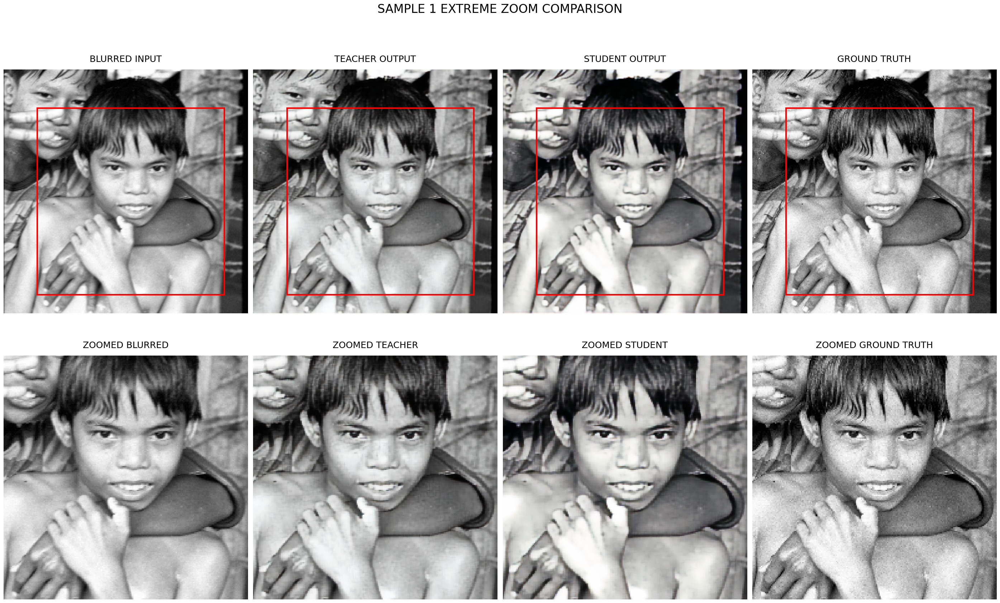

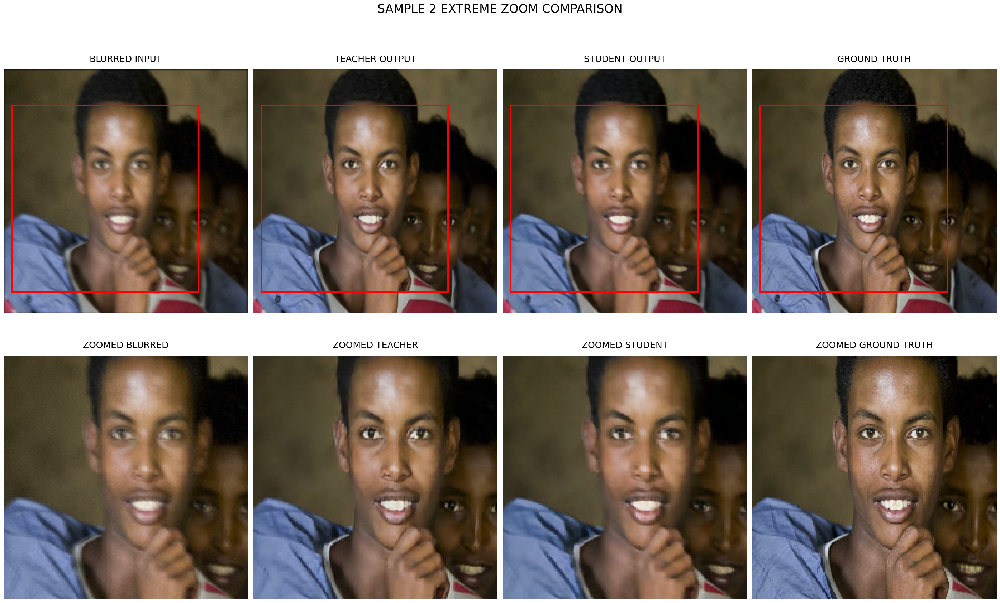

In [17]:

def visualize_detailed_zoom(num_samples=3, zoom_size=128):
    all_test_images = list(test_dataset.unbatch().shuffle(100).batch(1))
    selected_samples = random.sample(all_test_images, num_samples)
    
    for i, sample in enumerate(selected_samples):
        blur_batch, sharp_batch = sample
        teacher_pred = teacher_model(blur_batch).numpy()[0]
        student_pred = student_model(blur_batch).numpy()[0]
        blurred = blur_batch[0].numpy()
        sharp = sharp_batch[0].numpy()
        
        # Select random zoom region
        h, w = IMG_HEIGHT, IMG_WIDTH
        zoom_y = random.randint(0, h - zoom_size - 1)
        zoom_x = random.randint(0, w - zoom_size - 1)
        
        # Create zoomed versions
        zoomed_blur = blurred[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_teacher = teacher_pred[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_student = student_pred[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        zoomed_sharp = sharp[zoom_y:zoom_y+zoom_size, zoom_x:zoom_x+zoom_size]
        
        # Create figure with adjusted layout
        fig, ax = plt.subplots(2, 4, figsize=(28, 18))  # Increased height
        
        # Full images with zoom area
        ax[0,0].imshow(blurred)
        ax[0,0].add_patch(plt.Rectangle((zoom_x, zoom_y), zoom_size, zoom_size, 
                                      fill=False, edgecolor='red', linewidth=3))
        ax[0,0].set_title('BLURRED INPUT', fontsize=18, pad=15)  # Added padding
        ax[0,0].axis('off')
        
        ax[0,1].imshow(teacher_pred)
        ax[0,1].add_patch(plt.Rectangle((zoom_x, zoom_y), zoom_size, zoom_size, 
                                      fill=False, edgecolor='red', linewidth=3))
        ax[0,1].set_title('TEACHER OUTPUT', fontsize=18, pad=15)
        ax[0,1].axis('off')
        
        ax[0,2].imshow(student_pred)
        ax[0,2].add_patch(plt.Rectangle((zoom_x, zoom_y), zoom_size, zoom_size, 
                                      fill=False, edgecolor='red', linewidth=3))
        ax[0,2].set_title('STUDENT OUTPUT', fontsize=18, pad=15)
        ax[0,2].axis('off')
        
        ax[0,3].imshow(sharp)
        ax[0,3].add_patch(plt.Rectangle((zoom_x, zoom_y), zoom_size, zoom_size, 
                                      fill=False, edgecolor='red', linewidth=3))
        ax[0,3].set_title('GROUND TRUTH', fontsize=18, pad=15)
        ax[0,3].axis('off')
        
        # Zoomed regions
        ax[1,0].imshow(zoomed_blur)
        ax[1,0].set_title('ZOOMED BLURRED', fontsize=18, pad=15)
        ax[1,0].axis('off')
        
        ax[1,1].imshow(zoomed_teacher)
        ax[1,1].set_title('ZOOMED TEACHER', fontsize=18, pad=15)
        ax[1,1].axis('off')
        
        ax[1,2].imshow(zoomed_student)
        ax[1,2].set_title('ZOOMED STUDENT', fontsize=18, pad=15)
        ax[1,2].axis('off')
        
        ax[1,3].imshow(zoomed_sharp)
        ax[1,3].set_title('ZOOMED GROUND TRUTH', fontsize=18, pad=15)
        ax[1,3].axis('off')
        
        # Adjust overall layout
        plt.subplots_adjust(wspace=0.05, hspace=0.2)  # Added vertical/horizontal spacing
        plt.suptitle(f'SAMPLE {i+1} EXTREME ZOOM COMPARISON', fontsize=24, y=0.98)  # Adjusted vertical position
        plt.tight_layout(rect=[0, 0, 1, 0.96])  # Leave space for suptitle
        plt.show()

print("\n=== EXTREME ZOOM COMPARISON (NEW) ===")
visualize_detailed_zoom(num_samples=2, zoom_size=196)


=== LARGE FORMAT SIDE-BY-SIDE COMPARISON ===


/tmp/ipykernel_36/2642681224.py:63: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 1, 0.93])  # Reserve space for suptitle


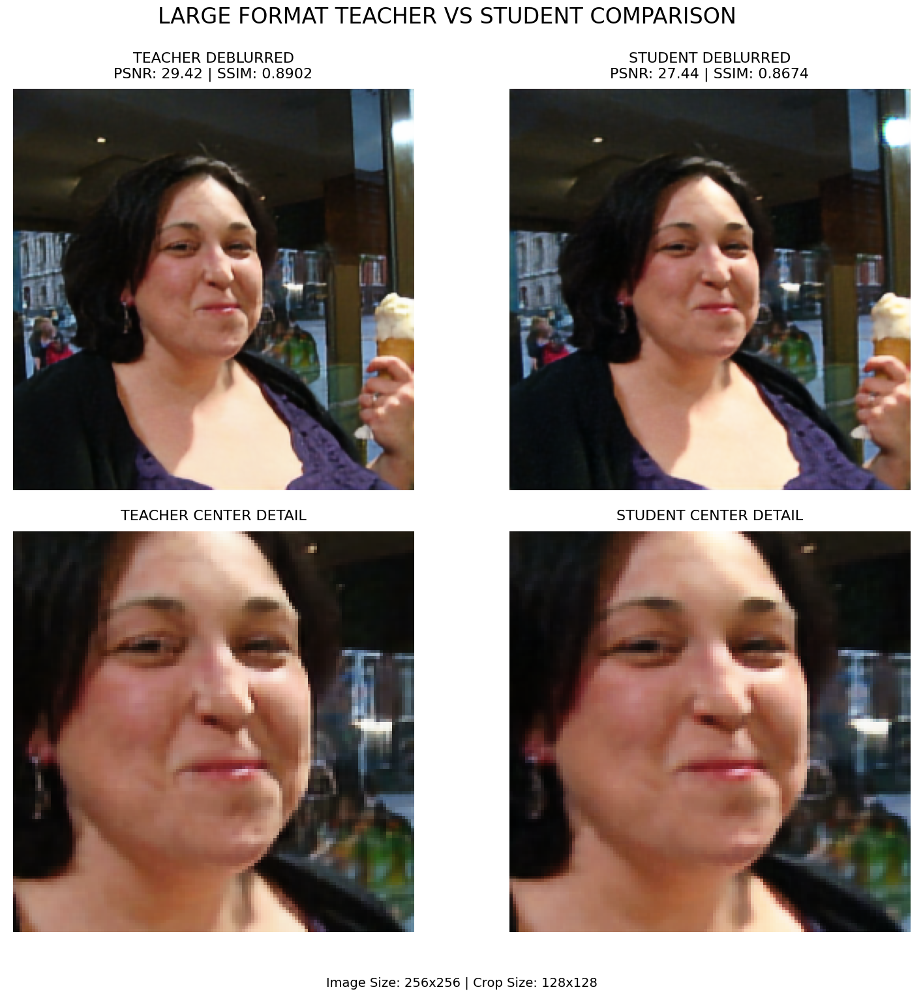

In [18]:
def large_side_by_side():
    all_test_images = list(test_dataset.unbatch().shuffle(100).batch(1))
    sample = random.choice(all_test_images)
    blur_batch, sharp_batch = sample
    teacher_pred = teacher_model(blur_batch).numpy()[0]
    student_pred = student_model(blur_batch).numpy()[0]
    sharp_img = sharp_batch[0].numpy()
    
    # Calculate metrics
    t_psnr = tf.image.psnr(sharp_batch, teacher_pred, max_val=1.0).numpy()[0]
    t_ssim = ssim(sharp_img, teacher_pred, channel_axis=-1, data_range=1.0)
    s_psnr = tf.image.psnr(sharp_batch, student_pred, max_val=1.0).numpy()[0]
    s_ssim = ssim(sharp_img, student_pred, channel_axis=-1, data_range=1.0)
    
    # Create figure with adjusted layout
    fig = plt.figure(figsize=(18, 18))
    
    # Main title
    fig.suptitle('LARGE FORMAT TEACHER VS STUDENT COMPARISON', 
                fontsize=24, y=0.95)
    
    # Create gridspec for better layout control
    gs = fig.add_gridspec(3, 2, height_ratios=[1, 1, 0.05], hspace=0.15)
    
    # Teacher Full
    ax1 = fig.add_subplot(gs[0, 0])
    ax1.imshow(teacher_pred)
    ax1.set_title(f'TEACHER DEBLURRED\nPSNR: {t_psnr:.2f} | SSIM: {t_ssim:.4f}', 
                 fontsize=16, pad=12)
    ax1.axis('off')
    
    # Student Full
    ax2 = fig.add_subplot(gs[0, 1])
    ax2.imshow(student_pred)
    ax2.set_title(f'STUDENT DEBLURRED\nPSNR: {s_psnr:.2f} | SSIM: {s_ssim:.4f}', 
                 fontsize=16, pad=12)
    ax2.axis('off')
    
    # Teacher Detail (center crop)
    crop_size = min(IMG_HEIGHT, IMG_WIDTH) // 2
    start_y = (IMG_HEIGHT - crop_size) // 2
    start_x = (IMG_WIDTH - crop_size) // 2
    teacher_crop = teacher_pred[start_y:start_y+crop_size, start_x:start_x+crop_size]
    
    ax3 = fig.add_subplot(gs[1, 0])
    ax3.imshow(teacher_crop)
    ax3.set_title('TEACHER CENTER DETAIL', fontsize=16, pad=12)
    ax3.axis('off')
    
    # Student Detail (center crop)
    student_crop = student_pred[start_y:start_y+crop_size, start_x:start_x+crop_size]
    ax4 = fig.add_subplot(gs[1, 1])
    ax4.imshow(student_crop)
    ax4.set_title('STUDENT CENTER DETAIL', fontsize=16, pad=12)
    ax4.axis('off')
    
    # Add colorbar for reference
    cax = fig.add_subplot(gs[2, :])
    cax.axis('off')
    cax.text(0.5, 0.5, f"Image Size: {IMG_WIDTH}x{IMG_HEIGHT} | Crop Size: {crop_size}x{crop_size}",
             ha='center', va='center', fontsize=14)
    
    plt.tight_layout(rect=[0, 0, 1, 0.93])  # Reserve space for suptitle
    plt.show()

print("\n=== LARGE FORMAT SIDE-BY-SIDE COMPARISON ===")
large_side_by_side()


=== ENHANCED DIRECT COMPARISONS ===


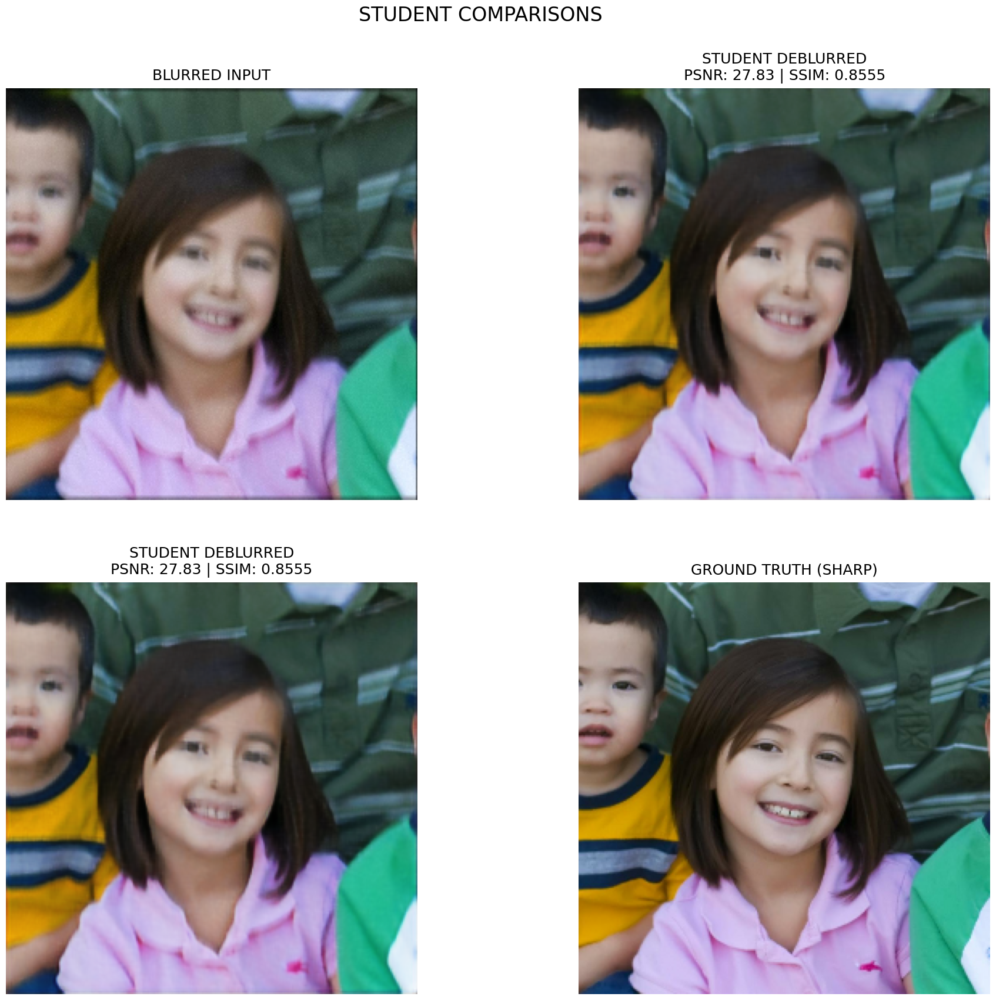

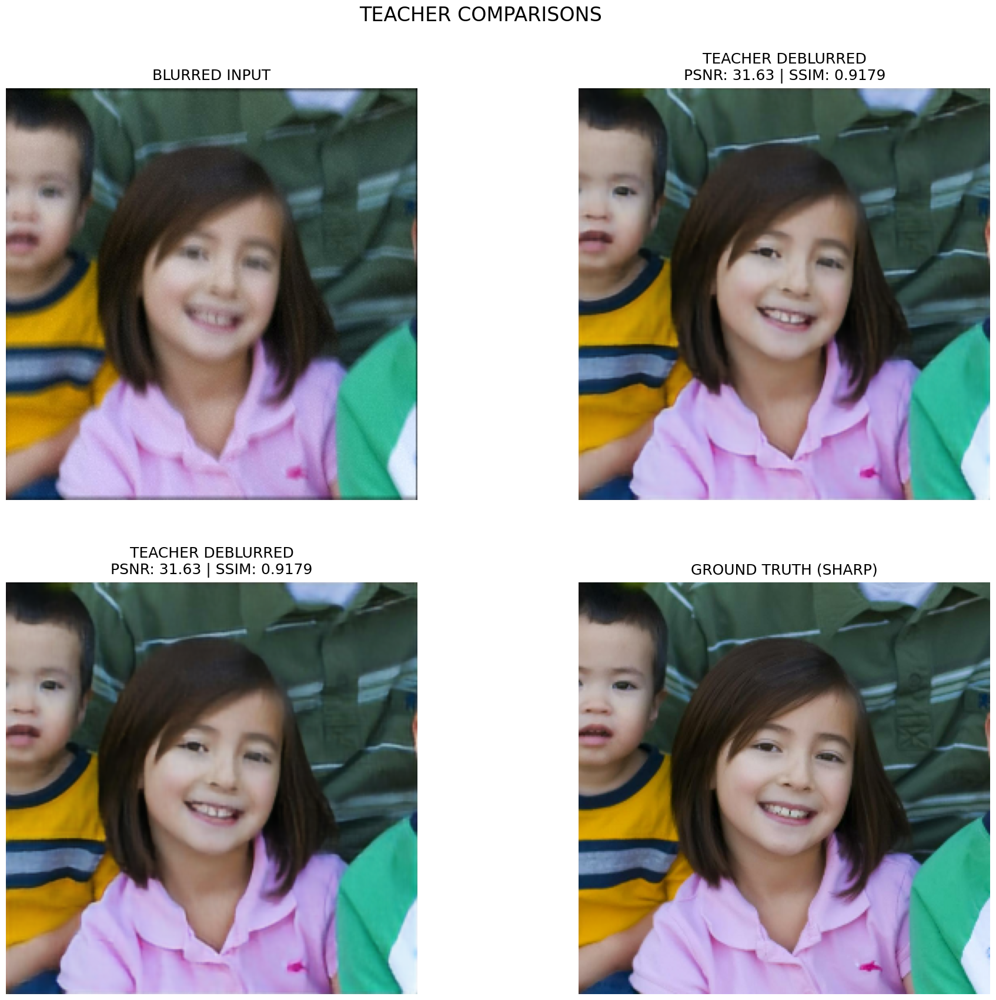

In [20]:

def enhanced_direct_comparisons():
    all_test_images = list(test_dataset.unbatch().shuffle(100).batch(1))
    sample = random.choice(all_test_images)
    blur_batch, sharp_batch = sample
    teacher_pred = teacher_model(blur_batch).numpy()[0]
    student_pred = student_model(blur_batch).numpy()[0]
    blurred = blur_batch[0].numpy()
    sharp = sharp_batch[0].numpy()
    
    # Calculate metrics
    t_psnr = tf.image.psnr(sharp_batch, teacher_pred, max_val=1.0).numpy()[0]
    t_ssim = ssim(sharp, teacher_pred, multichannel=True, channel_axis=-1, data_range=1.0)
    s_psnr = tf.image.psnr(sharp_batch, student_pred, max_val=1.0).numpy()[0]
    s_ssim = ssim(sharp, student_pred, multichannel=True, channel_axis=-1, data_range=1.0)
    
    # Create figure with proper spacing
    fig, ax = plt.subplots(2, 2, figsize=(24, 20))
    plt.subplots_adjust(wspace=0.1, hspace=0.2)
    
    # Student vs Blur
    ax[0,0].imshow(blurred)
    ax[0,0].set_title('BLURRED INPUT', fontsize=18, pad=10)
    ax[0,0].axis('off')
    
    ax[0,1].imshow(student_pred)
    ax[0,1].set_title(f'STUDENT DEBLURRED\nPSNR: {s_psnr:.2f} | SSIM: {s_ssim:.4f}', fontsize=18, pad=10)
    ax[0,1].axis('off')
    
    # Student vs Sharp
    ax[1,0].imshow(student_pred)
    ax[1,0].set_title(f'STUDENT DEBLURRED\nPSNR: {s_psnr:.2f} | SSIM: {s_ssim:.4f}', fontsize=18, pad=10)
    ax[1,0].axis('off')
    
    ax[1,1].imshow(sharp)
    ax[1,1].set_title('GROUND TRUTH (SHARP)', fontsize=18, pad=10)
    ax[1,1].axis('off')
    
    plt.suptitle('STUDENT COMPARISONS', fontsize=24, y=0.95)
    plt.show()
    
    # Create another figure for teacher
    fig, ax = plt.subplots(2, 2, figsize=(24, 20))
    plt.subplots_adjust(wspace=0.1, hspace=0.2)
    
    # Teacher vs Blur
    ax[0,0].imshow(blurred)
    ax[0,0].set_title('BLURRED INPUT', fontsize=18, pad=10)
    ax[0,0].axis('off')
    
    ax[0,1].imshow(teacher_pred)
    ax[0,1].set_title(f'TEACHER DEBLURRED\nPSNR: {t_psnr:.2f} | SSIM: {t_ssim:.4f}', fontsize=18, pad=10)
    ax[0,1].axis('off')
    
    # Teacher vs Sharp
    ax[1,0].imshow(teacher_pred)
    ax[1,0].set_title(f'TEACHER DEBLURRED\nPSNR: {t_psnr:.2f} | SSIM: {t_ssim:.4f}', fontsize=18, pad=10)
    ax[1,0].axis('off')
    
    ax[1,1].imshow(sharp)
    ax[1,1].set_title('GROUND TRUTH (SHARP)', fontsize=18, pad=10)
    ax[1,1].axis('off')
    
    plt.suptitle('TEACHER COMPARISONS', fontsize=24, y=0.95)
    plt.show()

print("\n=== ENHANCED DIRECT COMPARISONS ===")
enhanced_direct_comparisons()